<a href="https://colab.research.google.com/github/JillSunday/Breast-Tumor-Prediction-Model-in-African-Healthcare-Setting/blob/main/Notebook/BREAST_TUMOR_ULTRASOUND_IMAGE_SEGMENTATION.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ***INTRODUCTION***
The utilization of outdated ultrasound equipment with substandard image quality, alongside challenges such as inconsistent power supply and limited maintenance capacity, poses significant obstacles to the provision of reliable ultrasound services, especially in rural Africa. Furthermore, accuartely delineating breast tumors proves challenging using the ultrasound as the preffered imaging modality.  In response to these challenges, this project aims to create an accurate, automated breast tumor segmentation model customized to address the unique needs of the sub-Saharan African population.

## Loading the dataset into ***colab***

In [ ]:
#Required module
#pip install openpyxl

import pandas as pd
import cv2


In [ ]:
#define .xlsx filename and folder containing images and masks
info_filename = r'BrEaST-Lesions-USG-clinical-data-Sep-2023-with-data-dictionary-v2-Nov-7-2023.xlsx'
images_and_masks_foldername = r'BrEaST-Lesions_USG-images_and_masks/'

In [ ]:
#read .xlsx file with clinical data
breast_dataset = pd.read_excel(info_filename, sheet_name='BrEaST-Lesions-USG clinical dat')


In [ ]:
for i in breast_dataset.index:
    #parse milti-label columns
    breast_dataset.at[i, 'Tissue_composition'] = breast_dataset.loc[i,'Tissue_composition'].split('&')
    breast_dataset.at[i, 'Signs'] = breast_dataset.loc[i,'Signs'].split('&')
    breast_dataset.at[i, 'Symptoms'] = breast_dataset.loc[i,'Symptoms'].split('&')
    breast_dataset.at[i, 'Margin'] = breast_dataset.loc[i,'Margin'].split('&')
    breast_dataset.at[i, 'Interpretation'] = breast_dataset.loc[i,'Interpretation'].split('&')
    breast_dataset.at[i, 'Diagnosis'] = breast_dataset.loc[i,'Diagnosis'].split('&')


In [ ]:
#read image
breast_dataset.at[i, 'Image_filename']  = cv2.imread(images_and_masks_foldername+breast_dataset.loc[i,'Image_filename'], cv2.IMREAD_UNCHANGED)


In [ ]:
# Read the grayscale image
gray_image = cv2.imread(images_and_masks_foldername + breast_dataset.loc[i, 'Mask_tumor_filename'], cv2.IMREAD_GRAYSCALE)

# Threshold the grayscale image to generate a binary mask
_, binary_mask = cv2.threshold(gray_image, 0, 255, cv2.THRESH_BINARY)

# Store the binary mask in the dataset
breast_dataset.at[i, 'Mask_tumor_filename'] = binary_mask


In [ ]:
#read other mask
if not isinstance(breast_dataset.loc[i,'Mask_other_filename'], float):
        masks_bool = []
        for mask_path in breast_dataset.loc[i,'Mask_other_filename'].split('&'):
            masks_bool.append(cv2.imread(images_and_masks_foldername+mask_path, cv2.IMREAD_GRAYSCALE)>0)
        breast_dataset.at[i, 'Mask_other_filename'] = masks_bool
else:
        breast_dataset.at[i, 'Mask_other_filename'] = []


In [ ]:
#columns rename
breast_dataset.rename(columns={"Image_filename": "Image", "Mask_tumor_filename": "Mask_tumor", "Mask_other_filename": "Mask_other"})

,CaseID,Image,Mask_tumor,Mask_other,Pixel_size,Age,Tissue_composition,Signs,Symptoms,Shape,...,Echogenicity,Posterior_features,Halo,Calcifications,Skin_thickening,Interpretation,BIRADS,Verification,Diagnosis,Classification
0,1,case001.png,case001_tumor.png,NaN,0.007812,57,[heterogeneous: predominantly fat],[breast scar],[family history of breast/ovarian cancer],irregular,...,heterogeneous,shadowing,no,no,yes,"[Breast scar (surgery), Breast scar (radiother...",2,confirmed by follow-up care,[not applicable],benign
1,2,case002.png,case002_tumor.png,NaN,0.006462,not available,[homogeneous: fat],[not available],[not available],oval,...,hypoechoic,no,no,no,no,"[Dysplasia, Fibroadenoma]",4b,confirmed by biopsy,[Intramammary lymph node],benign
2,3,case003.png,case003_tumor.png,NaN,0.006944,56,[heterogeneous: predominantly fat],[no],[nipple discharge],oval,...,hyperechoic,no,no,no,no,"[Duct filled with thick fluid, Intraductal pap...",4a,confirmed by biopsy,"[Usual ductal hyperplasia (UDH), Pseudoangioma...",benign
3,4,case004.png,case004_tumor.png,NaN,0.007812,43,[homogeneous: fibroglandular],[no],[no],round,...,hypoechoic,no,no,no,no,[Cyst filled with thick fluid],3,confirmed by follow-up care,[not applicable],benign
4,5,case005.png,case005_tumor.png,NaN,0.007812,67,[homogeneous: fat],"[nipple retraction, palpable]",[family history of breast/ovarian cancer],oval,...,complex cystic/solid,enhancement,no,no,no,"[Suspicion of malignancy, Intraductal papilloma]",4b,confirmed by biopsy,"[Encapsulated papillary carcinoma, Ductal carc...",malignant
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
251,252,case252.png,case252_tumor.png,NaN,0.006944,18,[homogeneous: fibroglandular],[palpable],[no],oval,...,hypoechoic,no,no,no,no,[Fibroadenoma],4a,confirmed by biopsy,[Fibroadenoma],benign
252,253,case253.png,case253_tumor.png,NaN,0.007812,64,[homogeneous: fat],"[palpable, breast scar]",[family history of breast/ovarian cancer],oval,...,anechoic,enhancement,no,no,yes,"[Fat necrosis, Breast scar (surgery)]",2,confirmed by follow-up care,[not applicable],benign
253,254,case254.png,case254_tumor.png,NaN,0.007812,57,[heterogeneous: predominantly fat],[no],[no],irregular,...,hypoechoic,shadowing,no,no,no,[Suspicion of malignancy],5,confirmed by biopsy,"[Invasive carcinoma of no special type (NST), ...",malignant
254,255,case255.png,case255_tumor.png,NaN,0.006944,42,[heterogeneous: predominantly fibroglandular],[palpable],[family history of breast/ovarian cancer],irregular,...,heterogeneous,shadowing,no,intraductal,no,"[Suspicion of malignancy, Mastitis]",4c,confirmed by biopsy,[Ductal carcinoma in situ (DCIS)],malignant


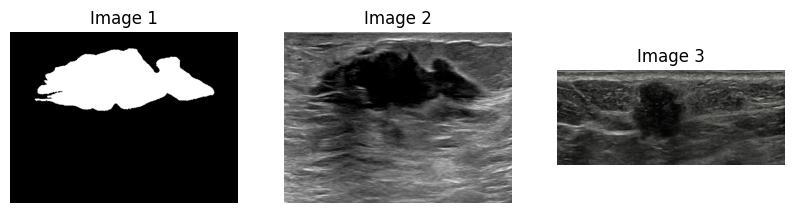

In [ ]:
#To visualize data
import matplotlib.pyplot as plt
import cv2

def visualize_images(image_paths, titles=None):
    num_images = len(image_paths)
    fig, axes = plt.subplots(1, num_images, figsize=(10, 5))
    for i, image_path in enumerate(image_paths):
        try:
            image = cv2.imread(image_path)
            if image is not None:
                axes[i].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
                axes[i].axis('off')
                if titles is not None:
                    axes[i].set_title(titles[i])
            else:
                print(f"Error reading image: {image_path}")
        except Exception as e:
            print(f"Error processing image: {image_path}\n{str(e)}")
    plt.show()

# Example usage
image_paths = [
    '/content/drive/MyDrive/BrEaST-Lesions_USG-images_and_masks/case251_tumor.png',
    '/content/drive/MyDrive/BrEaST-Lesions_USG-images_and_masks/case251.png',
    '/content/drive/MyDrive/BrEaST-Lesions_USG-images_and_masks/case088.png'
]
titles = ['Image 1', 'Image 2', 'Image 3']  # Optional titles for the images
visualize_images(image_paths, titles)


In [ ]:

#Code to check the size of an image
# Load the image
image_path = '/content/drive/MyDrive/BrEaST-Lesions_USG-images_and_masks/case068_tumor.png'
image = cv2.imread(image_path)

# Check if the image is loaded successfully
if image is not None:
    # Get the dimensions of the image
    height, width, channels = image.shape
    print(f"Image dimensions: Height={height}, Width={width}, Channels={channels}")
else:
    print("Error: Failed to load the image.")


Image dimensions: Height=532, Width=545, Channels=3


# ***Resizing images to 256 x 256***

In [ ]:
#Resizing the images to 256 x 256
import cv2
import os

def resize_images(input_folder, output_folder, target_size=(256, 256)):
    # Create the output folder if it doesn't exist
    os.makedirs(output_folder, exist_ok=True)

    # Iterate over the images in the input folder
    for filename in os.listdir(input_folder):
        # Read the image
        img_path = os.path.join(input_folder, filename)
        img = cv2.imread(img_path)

        # Resize the image
        resized_img = cv2.resize(img, target_size)

        # Save the resized image to the output folder
        output_path = os.path.join(output_folder, filename)
        cv2.imwrite(output_path, resized_img)

# Example usage
input_folder = '/content/drive/MyDrive/BrEaST-Lesions_USG-images_and_masks'
output_folder = '/content/resized_images'
resize_images(input_folder, output_folder)


In [ ]:
#To check if image has been resized
import cv2
# Load the image
image_path = '/content/resized_images/case077_tumor.png'
image = cv2.imread(image_path)

# Check if the image is loaded successfully
if image is not None:
    # Get the dimensions of the image
    height, width, channels = image.shape
    print(f"Image dimensions: Height={height}, Width={width}, Channels={channels}")
else:
    print("Error: Failed to load the image.")


Image dimensions: Height=256, Width=256, Channels=3


# ***Arranging images and masks to their respective sub-directories***

In [ ]:
import os

# Define the path to the resized_images folder
resized_images_folder = '/content/resized_images'

# Define the subdirectory names for images and masks
image_subdirectory = 'images'
mask_subdirectory = 'masks'

# Check if the subdirectories exist
image_subdirectory_path = os.path.join(resized_images_folder, image_subdirectory)
mask_subdirectory_path = os.path.join(resized_images_folder, mask_subdirectory)

if os.path.exists(image_subdirectory_path):
    print(f"Subdirectory '{image_subdirectory}' exists for images.")
else:
    print(f"Subdirectory '{image_subdirectory}' does not exist for images.")

if os.path.exists(mask_subdirectory_path):
    print(f"Subdirectory '{mask_subdirectory}' exists for masks.")
else:
    print(f"Subdirectory '{mask_subdirectory}' does not exist for masks.")


Subdirectory 'images' does not exist for images.
Subdirectory 'masks' does not exist for masks.


In [ ]:
#Create sub directory to the resized masks
import os

# Define the path to the resized_images directory
resized_images_dir = '/content/resized_images'

# Define the path to the masks directory within resized_images
masks_dir = os.path.join(resized_images_dir, 'masks')

# Check if the masks directory exists, if not, create it
if not os.path.exists(masks_dir):
    os.makedirs(masks_dir)
    print("Masks directory created successfully.")
else:
    print("Masks directory already exists.")


Masks directory created successfully.


In [ ]:
#Define sub directory to the resized images
import os

# Define the path to the resized_images directory
resized_images_dir = '/content/resized_images'

# Define the path to the images directory within resized_images
images_dir = os.path.join(resized_images_dir, 'images')

# Check if the images directory exists, if not, create it
if not os.path.exists(images_dir):
    os.makedirs(images_dir)
    print("Images directory created successfully.")
else:
    print("Images directory already exists.")


Images directory created successfully.


In [ ]:

import os
import shutil

# Define the path to the resized_images folder
resized_images_folder = '/content/resized_images'

# Define the subdirectory names for images and masks
image_subdirectory = 'images'
mask_subdirectory = 'masks'

# Create the image subdirectory if it doesn't exist
image_subdirectory_path = os.path.join(resized_images_folder, image_subdirectory)
os.makedirs(image_subdirectory_path, exist_ok=True)

# Create the mask subdirectory if it doesn't exist
mask_subdirectory_path = os.path.join(resized_images_folder, mask_subdirectory)
os.makedirs(mask_subdirectory_path, exist_ok=True)

# Get a list of all files in the resized_images folder
all_files = os.listdir(resized_images_folder)

# Move files to their respective subdirectories
for filename in all_files:
    src = os.path.join(resized_images_folder, filename)
    if'_tumor' in filename or '_other1' in filename or '_other2' in filename:
        # Move mask files to the mask subdirectory
        dst = os.path.join(mask_subdirectory_path, filename)
        shutil.move(src, dst)
        print(f"Moved mask file: {filename} to {mask_subdirectory}")
    elif filename.endswith('.png'):
        # Move image files to the images subdirectory
        dst = os.path.join(image_subdirectory_path, filename)
        shutil.move(src, dst)
        print(f"Moved image file: {filename} to {image_subdirectory}")

print("Files have been moved to their respective subdirectories.")


Moved mask file: case101_tumor.png to masks
Moved mask file: case182_tumor.png to masks
Moved mask file: case232_tumor.png to masks
Moved image file: case218.png to images
Moved mask file: case070_tumor.png to masks
Moved image file: case242.png to images
Moved image file: case191.png to images
Moved mask file: case016_tumor.png to masks
Moved mask file: case034_tumor.png to masks
Moved image file: case022.png to images
Moved mask file: case120_tumor.png to masks
Moved mask file: case214_tumor.png to masks
Moved image file: case109.png to images
Moved image file: case167.png to images
Moved mask file: case013_tumor.png to masks
Moved image file: case017.png to images
Moved image file: case040.png to images
Moved mask file: case173_tumor.png to masks
Moved mask file: case248_tumor.png to masks
Moved image file: case253.png to images
Moved mask file: case247_tumor.png to masks
Moved image file: case146.png to images
Moved mask file: case042_tumor.png to masks
Moved mask file: case066_tum

In [ ]:

#To extract masks from the images subdirectory and directing them to the masks subdirectory
import os
import shutil

# Define the path to the resized_images folder
resized_images_folder = '/content/resized_images'

# Define the subdirectory names for images and labels
image_subdirectory = 'images'
mask_subdirectory = 'masks'

# Create the image subdirectory if it doesn't exist
image_subdirectory_path = os.path.join(resized_images_folder, image_subdirectory)
os.makedirs(image_subdirectory_path, exist_ok=True)

# Create the mask subdirectory if it doesn't exist
mask_subdirectory_path = os.path.join(resized_images_folder, mask_subdirectory)
os.makedirs(mask_subdirectory_path, exist_ok=True)

# Get a list of all files in the images subdirectory
image_files = os.listdir(image_subdirectory_path)

# Move masked images to the masks subdirectory
for filename in image_files:
    if '_tumor' in filename or '_other1' in filename or '_other2' in filename or '_other3' in filename or '_other4' in filename:
        src = os.path.join(image_subdirectory_path, filename)
        dst = os.path.join(mask_subdirectory_path, filename)
        shutil.move(src, dst)
        print(f"Moved masked image file: {filename} to {mask_subdirectory}")

print("Masked images have been moved to the masks subdirectory.")


Moved masked image file: case140_other3.png to masks
Moved masked image file: case140_other4.png to masks
Masked images have been moved to the masks subdirectory.


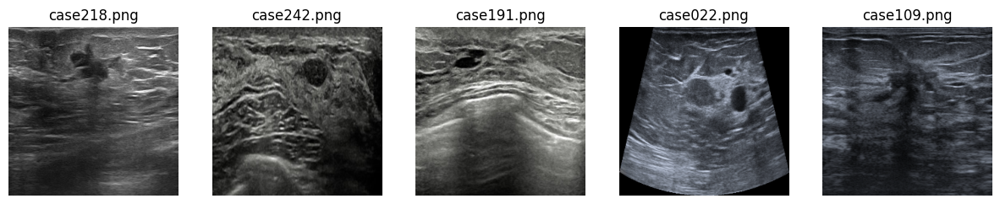

In [ ]:
#To visualize images in the images subdirectory in the resized_images directory
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Define the path to the images subdirectory
image_subdirectory = '/content/resized_images/images'

# Get a list of all files in the images subdirectory
image_files = os.listdir(image_subdirectory)

# Select the first 5 image files
selected_images = image_files[:5]

# Visualize the selected images
plt.figure(figsize=(15, 8))
for i, filename in enumerate(selected_images, 1):
    img_path = os.path.join(image_subdirectory, filename)
    img = mpimg.imread(img_path)
    plt.subplot(1, 5, i)
    plt.imshow(img)
    plt.title(filename)
    plt.axis('off')

plt.show()


# ***Synthesizing out-of-distribution data to simulate images acquired in Africa, using sub standard medical equipment***

In [ ]:
#To synthesize ood data, using the last 6 images and masks from resized_images directory
import os
import shutil
import imgaug.augmenters as iaa
from PIL import Image
import numpy as np

# Define paths
resized_images_directory = '/content/resized_images'
synthesized_data_directory = '/content/synthesized_data'
ood_images_directory = os.path.join(synthesized_data_directory, 'ood_images')
ood_masks_directory = os.path.join(synthesized_data_directory, 'ood_masks')

# Ensure directories exist
os.makedirs(ood_images_directory, exist_ok=True)
os.makedirs(ood_masks_directory, exist_ok=True)

# Get the last 6 images and masks
image_files = sorted(os.listdir(os.path.join(resized_images_directory, 'images')))[-6:]
mask_files = sorted(os.listdir(os.path.join(resized_images_directory, 'masks')))[-6:]

# Define augmentation pipeline
augmentation_pipeline = iaa.Sequential([
    iaa.Affine(rotate=(-10, 10)),  # Rotate images randomly between -10 to 10 degrees
    iaa.GaussianBlur(sigma=(0.0, 1.5)),  # Apply Gaussian blur with a sigma between 0.0 to 1.5
    iaa.AdditiveGaussianNoise(scale=(0, 0.075*255)),  # Add Gaussian noise with a scale of 0 to 0.075 times 255
])

# Synthesize OOD examples
for image_file, mask_file in zip(image_files, mask_files):
    src_image = os.path.join(resized_images_directory, 'images', image_file)
    src_mask = os.path.join(resized_images_directory, 'masks', mask_file)
    dst_image = os.path.join(ood_images_directory, image_file)
    dst_mask = os.path.join(ood_masks_directory, mask_file)

    # Augment image
    image = Image.open(src_image)
    augmented_image = augmentation_pipeline(image=np.array(image))
    augmented_image = Image.fromarray(augmented_image)

    # Copy augmented image and mask to ood directories
    augmented_image.save(dst_image)
    shutil.copy(src_mask, dst_mask)

print("OOD images and masks synthesized successfully with augmentation.YAAAAYYYYY!!!!")


OOD images and masks synthesized successfully with augmentation.YAAAAYYYYY!!!!


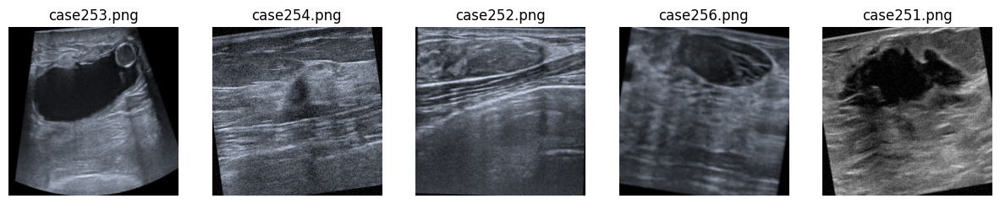

In [ ]:
#To visualize 5 images from ood_images subdirectory
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Define the path to the ood_images subdirectory
ood_images_directory = '/content/synthesized_data/ood_images'

# Get a list of all files in the ood_images subdirectory
ood_image_files = os.listdir(ood_images_directory)

# Select the first 5 image files
selected_ood_images = ood_image_files[:5]

# Visualize the selected images
plt.figure(figsize=(15, 8))
for i, filename in enumerate(selected_ood_images, 1):
    img_path = os.path.join(ood_images_directory, filename)
    img = mpimg.imread(img_path)
    plt.subplot(1, 5, i)
    plt.imshow(img)
    plt.title(filename)
    plt.axis('off')

plt.show()


In [ ]:
import os
#Renaming the ood data such it it is a continuation from the original dataset to prevent duplicates
# Directory containing synthesized OOD images and masks
ood_images_dir = "/content/synthesized_data/ood_images"
ood_masks_dir = "/content/synthesized_data/ood_masks"

# Define the range for the new case numbers
ood_start_index = 257
ood_end_index = 262

# Initialize a counter for the OOD cases
ood_counter = 0

# Iterate over the images directory
for filename in os.listdir(ood_images_dir):
    if filename.endswith(".png"):
        # Increment the counter
        ood_counter += 1

        # Check if the counter is within the desired range
        if 1 <= ood_counter <= 6:
            # new filename
            new_filename = f"case{ood_start_index + ood_counter - 1}.png"
            # full paths
            old_filepath = os.path.join(ood_images_dir, filename)
            new_filepath = os.path.join(ood_images_dir, new_filename)

            # Rename the file
            os.rename(old_filepath, new_filepath)

            # Print the renaming information
            print(f"Renamed {filename} to {new_filename}")

# Reset the counter for the masks
ood_counter = 0

# Iterate over the masks directory
for filename in os.listdir(ood_masks_dir):
    if filename.endswith(".png"):
        # Increment the counter
        ood_counter += 1

        #counter is within the desired range
        if 1 <= ood_counter <= 6:
            # Construct the new filename
            new_filename = f"case{ood_start_index + ood_counter - 1}_tumor.png"
            # Construct the full paths
            old_filepath = os.path.join(ood_masks_dir, filename)
            new_filepath = os.path.join(ood_masks_dir, new_filename)

            # Rename the file
            os.rename(old_filepath, new_filepath)

            # Print the renaming information
            print(f"Renamed {filename} to {new_filename}")

print("Renaming completed.")


Renamed case253.png to case257.png
Renamed case254.png to case258.png
Renamed case252.png to case259.png
Renamed case256.png to case260.png
Renamed case251.png to case261.png
Renamed case255.png to case262.png
Renamed case256_tumor.png to case257_tumor.png
Renamed case251_tumor.png to case258_tumor.png
Renamed case252_tumor.png to case259_tumor.png
Renamed case255_tumor.png to case260_tumor.png
Renamed case254_tumor.png to case261_tumor.png
Renamed case253_tumor.png to case262_tumor.png
Renaming completed.


# ***Merging the original dataset with the newly synthesized dataset***

In [ ]:
#This is to merge the resized_images and synthesized_ood
import os
import shutil

# Define paths
resized_images_directory = '/content/resized_images'
synthesized_data_directory = '/content/synthesized_data'
merged_dataset_directory = '/content/merged_dataset'
merged_images_directory = os.path.join(merged_dataset_directory, 'merged_images')
merged_masks_directory = os.path.join(merged_dataset_directory, 'merged_masks')

# Create merged_dataset_directory if it doesn't exist
os.makedirs(merged_dataset_directory, exist_ok=True)
os.makedirs(merged_images_directory, exist_ok=True)
os.makedirs(merged_masks_directory, exist_ok=True)

# Copy images from resized_images/images to merged_dataset/merged_images
for filename in os.listdir(os.path.join(resized_images_directory, 'images')):
    src = os.path.join(resized_images_directory, 'images', filename)
    dst = os.path.join(merged_images_directory, filename)
    shutil.copy(src, dst)
    print(f"Copied image: {filename} to merged_images")

# Copy images from synthesized_data/ood_images to merged_dataset/merged_images
for filename in os.listdir(os.path.join(synthesized_data_directory, 'ood_images')):
    src = os.path.join(synthesized_data_directory, 'ood_images', filename)
    dst = os.path.join(merged_images_directory, filename)
    shutil.copy(src, dst)
    print(f"Copied image: {filename} to merged_images")

# Copy masks from resized_images/masks to merged_dataset/merged_masks
for filename in os.listdir(os.path.join(resized_images_directory, 'masks')):
    src = os.path.join(resized_images_directory, 'masks', filename)
    dst = os.path.join(merged_masks_directory, filename)
    shutil.copy(src, dst)
    print(f"Copied mask: {filename} to merged_masks")

# Copy masks from synthesized_data/ood_masks to merged_dataset/merged_masks
for filename in os.listdir(os.path.join(synthesized_data_directory, 'ood_masks')):
    src = os.path.join(synthesized_data_directory, 'ood_masks', filename)
    dst = os.path.join(merged_masks_directory, filename)
    shutil.copy(src, dst)
    print(f"Copied mask: {filename} to merged_masks")

print("Merge completed successfully.")

Copied image: case218.png to merged_images
Copied image: case242.png to merged_images
Copied image: case191.png to merged_images
Copied image: case022.png to merged_images
Copied image: case109.png to merged_images
Copied image: case167.png to merged_images
Copied image: case017.png to merged_images
Copied image: case040.png to merged_images
Copied image: case253.png to merged_images
Copied image: case146.png to merged_images
Copied image: case247.png to merged_images
Copied image: case008.png to merged_images
Copied image: case185.png to merged_images
Copied image: case195.png to merged_images
Copied image: case232.png to merged_images
Copied image: case248.png to merged_images
Copied image: case122.png to merged_images
Copied image: case079.png to merged_images
Copied image: case180.png to merged_images
Copied image: case037.png to merged_images
Copied image: case097.png to merged_images
Copied image: case250.png to merged_images
Copied image: case113.png to merged_images
Copied imag

# ***Cloning nnUNet into colab alongside all its packages***

In [ ]:
!git clone https://github.com/MIC-DKFZ/nnUNet.git /content/nnUNetFrame/nnUNet


Cloning into '/content/nnUNetFrame/nnUNet'...
remote: Enumerating objects: 11846, done.
remote: Counting objects: 100% (895/895), done.
remote: Compressing objects: 100% (335/335), done.
remote: Total 11846 (delta 618), reused 755 (delta 557), pack-reused 10951
Receiving objects: 100% (11846/11846), 7.67 MiB | 27.27 MiB/s, done.
Resolving deltas: 100% (9009/9009), done.


In [ ]:
%cd /content/nnUNetFrame/nnUNet
!pip install -e .
!pip install numpy scipy SimpleITK batchgenerators


/content/nnUNetFrame/nnUNet
Obtaining file:///content/nnUNetFrame/nnUNet
  Installing build dependencies ... done
  Checking if build backend supports build_editable ... done
  Getting requirements to build editable ... done
  Preparing editable metadata (pyproject.toml) ... done
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 3.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.7/61.7 kB 8.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.7/52.7 MB 16.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 39.6/39.6 MB 19.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 94.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 96.4/96.4 kB 14.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 65.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━

  Using cached argparse-1.4.0-py2.py3-none-any.whl (23 kB)


# ***Installing hidden layer***

In [ ]:
import os
nnunet_dir = '/content/nnUNetFrame/nnUNet'
os.chdir(nnunet_dir)
!pip install --upgrade git+https://github.com/FabianIsensee/hiddenlayer.git


  Cloning https://github.com/FabianIsensee/hiddenlayer.git to /tmp/pip-req-build-d6b__oz1
  Running command git clone --filter=blob:none --quiet https://github.com/FabianIsensee/hiddenlayer.git /tmp/pip-req-build-d6b__oz1
  Resolved https://github.com/FabianIsensee/hiddenlayer.git to commit b7263b6dc4569da1b6dea5964e1eac78fa32fa77
  Preparing metadata (setup.py) ... done
  Created wheel for hiddenlayer: filename=hiddenlayer-0.2-py3-none-any.whl size=20003 sha256=c26aeef991b2ada5a7540fe2742ca1082883e3df12af230f06dcc37492f6041c
  Stored in directory: /tmp/pip-ephem-wheel-cache-502wt1b_/wheels/55/0e/e3/fdf2f92789305c0e320e0ab01f27fd4b757b1bb01c07d532c4
Successfully built hiddenlayer


# ***Creating folder structure as per nnUNet requirements***

In [ ]:
import os
root_dir = '/content/nnUNetFrame'
nnunet_dir = os.path.join(root_dir, 'nnUNet')
os.makedirs(nnunet_dir, exist_ok=True)
dataset_dir = os.path.join(root_dir, 'dataset')
os.makedirs(dataset_dir, exist_ok=True)
subfolders = ['nnUNet_raw', 'nnUNet_preprocessed', 'nnUNet_results']
for subfolder in subfolders:
    subfolder_path = os.path.join(dataset_dir, subfolder)
    os.makedirs(subfolder_path, exist_ok=True)
nnunet_raw_dir = os.path.join(dataset_dir, 'nnUNet_raw')
raw_subfolders = ['nnUNet_raw_data', 'nnUNet_cropped_data']
for subfolder in raw_subfolders:
    subfolder_path = os.path.join(nnunet_raw_dir, subfolder)
    os.makedirs(subfolder_path, exist_ok=True)

print("Folder structure created successfully.")


Folder structure created successfully.


# ***Setting up environments***

In [ ]:
%env nnUNet_raw=/content/nnUNetFrame/dataset/nnUNet_raw
%env nnUNet_preprocessed=/content/nnUNetFrame/dataset/nnUNet_preprocessed
%env nnUNet_results=/content/nnUNetFrame/dataset/nnUNet_results


env: nnUNet_raw=/content/nnUNetFrame/dataset/nnUNet_raw
env: nnUNet_preprocessed=/content/nnUNetFrame/dataset/nnUNet_preprocessed
env: nnUNet_results=/content/nnUNetFrame/dataset/nnUNet_results


# ***Convert dataset to nifti format***

In [ ]:
#To convert images and corresponding ground truth masks to nifti format
import os
import shutil
import nibabel as nib
import numpy as np
import cv2

# Define paths
merged_dataset_directory = '/content/merged_dataset'
nnunet_raw_data_dir = '/content/nnUNetFrame/dataset/nnUNet_raw/nnUNet_raw_data'
nifti_images_dir = os.path.join(nnunet_raw_data_dir, 'nifti_images')
nifti_masks_dir = os.path.join(nnunet_raw_data_dir, 'nifti_masks')

# Function to load image data
def load_image(input_path):
    # Load image using OpenCV
    image = cv2.imread(input_path, cv2.IMREAD_GRAYSCALE)  # Load image as grayscale
    return image

# Function to convert image or mask  to NIfTI format
def convert_to_nifti(input_directory, output_type):
    # Define output directory for NIfTI files
    output_nifti_directory = os.path.join(nnunet_raw_data_dir, f'nifti_{output_type}')

    # Create output directory for NIfTI files if it doesn't exist
    os.makedirs(output_nifti_directory, exist_ok=True)

    # Determine input directory for images or masks
    if output_type == 'images':
        input_directory = os.path.join(input_directory, 'merged_images')
    elif output_type == 'masks':
        input_directory = os.path.join(input_directory, 'merged_masks')

    # Function to convert image or mask to NIfTI format
    def convert_to_nifti_single(input_path, output_path):
        # Load image or mask data
        data = load_image(input_path)

        # Convert data type to integer (for masks)
        if output_type == 'masks':
            data = data.astype(np.int16)

        # Create NIfTI image object
        nifti_img = nib.Nifti1Image(data, np.eye(4))  # Assuming identity affine matrix

        # Save NIfTI image
        nib.save(nifti_img, output_path)
        print(f"Saved NIfTI {output_type} image: {output_path}")

    # Iterate over files in input directory
    for filename in os.listdir(input_directory):
        input_file = os.path.join(input_directory, filename)
        output_file = os.path.join(output_nifti_directory, f"{os.path.splitext(filename)[0]}.nii.gz")  # Output file path (with .nii.gz extension)
        convert_to_nifti_single(input_file, output_file)

# Convert images to NIfTI format
convert_to_nifti(merged_dataset_directory, 'images')

# Convert labels to NIfTI format
convert_to_nifti(merged_dataset_directory, 'masks')

print("Conversion completed. NIfTI files created.")

# Move NIfTI images and masks to nnUNet_raw_data directory
os.makedirs(nifti_images_dir, exist_ok=True)
os.makedirs(nifti_masks_dir, exist_ok=True)

# Move NIfTI images
for filename in os.listdir(os.path.join(nnunet_raw_data_dir, 'nifti_images')):
    source = os.path.join(nnunet_raw_data_dir, 'nifti_images', filename)
    dest = os.path.join(nifti_images_dir, filename)
    shutil.move(source, dest)

# Move NIfTI labels
for filename in os.listdir(os.path.join(nnunet_raw_data_dir, 'nifti_masks')):
    source = os.path.join(nnunet_raw_data_dir, 'nifti_masks', filename)
    dest = os.path.join(nifti_masks_dir, filename)
    shutil.move(source, dest)

print("NIfTI files moved to nnUNet_raw_data directory.")


Saved NIfTI images image: /content/nnUNetFrame/dataset/nnUNet_raw/nnUNet_raw_data/nifti_images/case218.nii.gz
Saved NIfTI images image: /content/nnUNetFrame/dataset/nnUNet_raw/nnUNet_raw_data/nifti_images/case242.nii.gz
Saved NIfTI images image: /content/nnUNetFrame/dataset/nnUNet_raw/nnUNet_raw_data/nifti_images/case191.nii.gz
Saved NIfTI images image: /content/nnUNetFrame/dataset/nnUNet_raw/nnUNet_raw_data/nifti_images/case022.nii.gz
Saved NIfTI images image: /content/nnUNetFrame/dataset/nnUNet_raw/nnUNet_raw_data/nifti_images/case109.nii.gz
Saved NIfTI images image: /content/nnUNetFrame/dataset/nnUNet_raw/nnUNet_raw_data/nifti_images/case167.nii.gz
Saved NIfTI images image: /content/nnUNetFrame/dataset/nnUNet_raw/nnUNet_raw_data/nifti_images/case017.nii.gz
Saved NIfTI images image: /content/nnUNetFrame/dataset/nnUNet_raw/nnUNet_raw_data/nifti_images/case040.nii.gz
Saved NIfTI images image: /content/nnUNetFrame/dataset/nnUNet_raw/nnUNet_raw_data/nifti_images/case253.nii.gz
Saved NIfT

# ***Renaming images to nnUNet format***

In [ ]:
#Rename the images and masks in the nnUNet format
import os

# Directory containing the nifti images and masks
images_dir = "/content/nnUNetFrame/dataset/nnUNet_raw/nnUNet_raw_data/nifti_images"
masks_dir = "/content/nnUNetFrame/dataset/nnUNet_raw/nnUNet_raw_data/nifti_masks"

# Iterate over the range of indices from 1 to 262
for i in range(1, 263):
    # Construct the filenames for images and labels
    image_filename = f"BT_{i:03d}_0000.nii.gz"
    mask_filename = f"BT_{i:03d}.nii.gz"

    # Construct the full paths for images and masks
    image_old_path = os.path.join(images_dir, f"case{i:03d}.nii.gz")
    mask_old_path = os.path.join(masks_dir, f"case{i:03d}_tumor.nii.gz")

    image_new_path = os.path.join(images_dir, image_filename)
    mask_new_path = os.path.join(masks_dir, mask_filename)

    # Skip if the image file or mask file does not exist
    if not os.path.exists(image_old_path) or not os.path.exists(mask_old_path):
        print(f"Image or mask file does not exist for case{i:03d}. Skipping... duuuhhh")
        continue

    # Skip if the mask file ends with _other1.nii.gz, _other2.nii.gz, _other3.nii.gz, or _other4.nii.gz
    if mask_old_path.endswith("_other1.nii.gz") or mask_old_path.endswith("_other2.nii.gz") or mask_old_path.endswith("_other3.nii.gz") or mask_old_path.endswith("_other4.nii.gz"):
        print(f"Mask file {mask_old_path} ends with _otherX.nii.gz. Skipping...  obviously")
        continue

    # Rename the images and masks
    os.rename(image_old_path, image_new_path)
    os.rename(mask_old_path, mask_new_path)

print("Renaming completed.")


Image or mask file does not exist for case045. Skipping... duuuhhh
Image or mask file does not exist for case061. Skipping... duuuhhh
Image or mask file does not exist for case209. Skipping... duuuhhh
Image or mask file does not exist for case213. Skipping... duuuhhh
Renaming completed.


In [ ]:
import os
##To delete files that start with 'case' because indiscrepancies ie, no corresponding masks, or too many corresponding mask (ie. those that have been skipped)
# Directory containing the nifti images and masks
images_dir = "/content/nnUNetFrame/dataset/nnUNet_raw/nnUNet_raw_data/nifti_images"
masks_dir = "/content/nnUNetFrame/dataset/nnUNet_raw/nnUNet_raw_data/nifti_masks"

# Delete files starting with 'case' in nifti_images directory
for filename in os.listdir(images_dir):
    if filename.startswith("case"):
        file_path = os.path.join(images_dir, filename)
        os.remove(file_path)

# Delete files starting with 'case' in nifti_masks directory
for filename in os.listdir(masks_dir):
    if filename.startswith("case"):
        file_path = os.path.join(masks_dir, filename)
        os.remove(file_path)

print("Deletion completed. Easier work wooohooo!")


Deletion completed. Easier work wooohooo!


# ***Generating labels for the images***

In [ ]:
import os
import SimpleITK as sitk
import numpy as np

# Define the labels for each region
Background_label = 0  # Blue
Tumor_label = 1  # Red

# Define the directory paths for masks and labels
mask_dir = '/content/nnUNetFrame/dataset/nnUNet_raw/nnUNet_raw_data/nifti_masks'
label_dir = '/content/nnUNetFrame/dataset/nnUNet_raw/nnUNet_raw_data/nifti_labels'

# Get list of mask files
mask_files = os.listdir(mask_dir)

# Iterate through each mask
for mask_file in mask_files:
    # Load mask image
    mask_path = os.path.join(mask_dir, mask_file)
    mask_img = sitk.ReadImage(mask_path)

    print(f"Loaded mask: {mask_file}")

    # Convert SimpleITK image to numpy array
    mask_np = sitk.GetArrayFromImage(mask_img)

    print("Converted mask to numpy array")

    # Create a new label image
    label_img = np.zeros_like(mask_np)

    # Assign labels to regions
    label_img[mask_np == 0] = Background_label  # Background
    label_img[mask_np != 0] = Tumor_label  # Tumor region (assuming any non-zero pixel belongs to tumor)

    print("Assigned labels to regions")

    # Save label image
    label_file = mask_file.replace('.nii.gz', '.nii.gz')
    label_path = os.path.join(label_dir, label_file)
    label_img_nifti = sitk.GetImageFromArray(label_img)
    sitk.WriteImage(label_img_nifti, label_path)

    print(f"Saved label image: {label_file}")


Loaded mask: BT_139.nii.gz
Converted mask to numpy array
Assigned labels to regions
Saved label image: BT_139.nii.gz
Loaded mask: BT_019.nii.gz
Converted mask to numpy array
Assigned labels to regions
Saved label image: BT_019.nii.gz
Loaded mask: BT_033.nii.gz
Converted mask to numpy array
Assigned labels to regions
Saved label image: BT_033.nii.gz
Loaded mask: BT_108.nii.gz
Converted mask to numpy array
Assigned labels to regions
Saved label image: BT_108.nii.gz
Loaded mask: BT_147.nii.gz
Converted mask to numpy array
Assigned labels to regions
Saved label image: BT_147.nii.gz
Loaded mask: BT_114.nii.gz
Converted mask to numpy array
Assigned labels to regions
Saved label image: BT_114.nii.gz
Loaded mask: BT_096.nii.gz
Converted mask to numpy array
Assigned labels to regions
Saved label image: BT_096.nii.gz
Loaded mask: BT_172.nii.gz
Converted mask to numpy array
Assigned labels to regions
Saved label image: BT_172.nii.gz
Loaded mask: BT_204.nii.gz
Converted mask to numpy array
Assigne

Image data shape: (256, 256)
Label data shape: (256, 256)


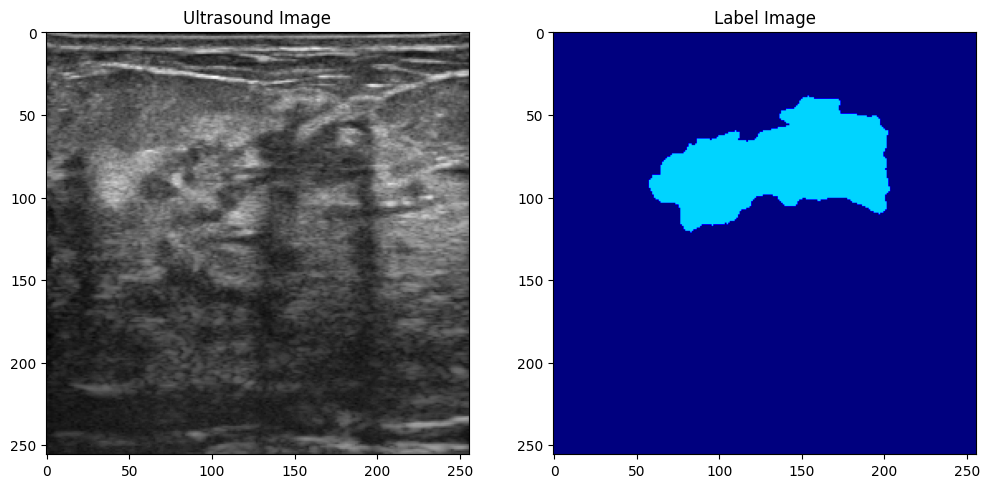

In [ ]:
import os
import nibabel as nib
import matplotlib.pyplot as plt

# Define the directory paths for images and labels
image_dir = '/content/nnUNetFrame/dataset/nnUNet_raw/nnUNet_raw_data/nifti_images'
label_dir = '/content/nnUNetFrame/dataset/nnUNet_raw/nnUNet_raw_data/nifti_labels'

# Choose an image file to visualize (replace 'image_file' with the actual file name)
image_file = 'BT_255_0000.nii.gz'
label_file = 'BT_255.nii.gz'

# Load the image and corresponding label
image_path = os.path.join(image_dir, image_file)
label_path = os.path.join(label_dir, label_file)

image_data = nib.load(image_path).get_fdata()
label_data = nib.load(label_path).get_fdata()

# Print the shape of the image data
print("Image data shape:", image_data.shape)

# Print the shape of the label data
print("Label data shape:", label_data.shape)

# Visualize the image and label
plt.figure(figsize=(12, 6))

# Plot the image
plt.subplot(1, 2, 1)
plt.imshow(image_data, cmap='gray')
plt.title('Ultrasound Image')

# Plot the label
plt.subplot(1, 2, 2)
plt.imshow(label_data, cmap='jet', vmin=0, vmax=3)  # Assuming 4 labels
plt.title('Label Image')

plt.show()


# ***Splitting dataset according to nnUNet requirements***

In [ ]:
#To split the dataset into imagesTr, labelsTr(for training) and imagesTs (for testing)
import os
import shutil
import random

# Function to split dataset
def split_dataset(images_dir, labels_dir, train_ratio=0.8, test_ratio=0.2, seed=42):
    random.seed(seed)

    # Get list of filenames
    image_filenames = os.listdir(images_dir)

    # Shuffle filenames
    random.shuffle(image_filenames)

    # Calculate number of images for each set
    num_images = len(image_filenames)
    num_train = int(train_ratio * num_images)
    num_test = num_images - num_train

    # Split filenames into sets
    train_images = image_filenames[:num_train]
    test_images = image_filenames[num_train:]

    return train_images, test_images

# Define paths
nnunet_raw_data_dir = '/content/nnUNetFrame/dataset/nnUNet_raw/nnUNet_raw_data'
nifti_images_dir = os.path.join(nnunet_raw_data_dir, 'nifti_images')
nifti_labels_dir = os.path.join(nnunet_raw_data_dir, 'nifti_labels')

# Split dataset
train_images, test_images = split_dataset(nifti_images_dir, nifti_labels_dir)

# Create Dataset001_BreastTumor Directory
nnunet_raw_dir = '/content/nnUNetFrame/dataset/nnUNet_raw'
dataset001_BreastTumor_dir = os.path.join(nnunet_raw_dir, 'Dataset001_BreastTumor')
os.makedirs(dataset001_BreastTumor_dir, exist_ok=True)

# Define directories for sets in Dataset001_BrainTumor
images_tr_dir = os.path.join(dataset001_BreastTumor_dir, 'imagesTr')
labels_tr_dir = os.path.join(dataset001_BreastTumor_dir, 'labelsTr')
images_ts_dir = os.path.join(dataset001_BreastTumor_dir, 'imagesTs')

# Create directories if they don't exist
os.makedirs(images_tr_dir, exist_ok=True)
os.makedirs(labels_tr_dir, exist_ok=True)
os.makedirs(images_ts_dir, exist_ok=True)

# Move images and labels to respective directories
for filename in train_images:
    image_src = os.path.join(nifti_images_dir, filename)
    label_src = os.path.join(nifti_labels_dir, filename.replace('_0000.nii.gz', '.nii.gz'))

    if os.path.exists(image_src) and os.path.exists(label_src):
        image_dest = os.path.join(images_tr_dir, filename)
        label_dest = os.path.join(labels_tr_dir, filename.replace('_0000.nii.gz', '.nii.gz'))
        shutil.move(image_src, image_dest)
        shutil.move(label_src, label_dest)

for filename in test_images:
    image_src = os.path.join(nifti_images_dir, filename)
    if os.path.exists(image_src):
        image_dest = os.path.join(images_ts_dir, filename)
        shutil.move(image_src, image_dest)

print("Dataset split into imagesTr, labelsTr, and imagesTs in Dataset001_BreastTumor directory.")


Dataset split into imagesTr, labelsTr, and imagesTs in Dataset001_BreastTumor directory.


# ***Generating json file***

In [ ]:
import json

def generate_dataset_json(output_file, channel_names, labels, dataset_name, description, reference, release, license, additional_params, num_training, file_ending):
    dataset_info = {
        "channel_names": channel_names,
        "labels": labels,
        "dataset_name": dataset_name,
        "description": description,
        "reference": reference,
        "release": release,
        "license": license,
        "additional_params": additional_params,
        "numTraining": num_training,
        "file_ending": file_ending
    }

    with open(output_file, 'w') as f:
        json.dump(dataset_info, f, indent=4)

# Define dataset information
channel_names = {
    0: 'ultrasound'  # Since breast ultrasound scans are typically grayscale images, there is only one channel
}
labels = {
    'background': 0,  #blue
    'tumor': 1,  #red
}
dataset_name = 'BrEast-Lesions_USG_images_and_masks'
description = """Dataset containing breast ultrasound scans with labels and annotations.
Preprocessing:
- Resizing: Images were resized to a fixed resolution of (256, 256) to standardize the input size for the neural network model.
- Augmentation: Augmentation techniques such as rotation, flipping, and adding Gaussian and K- noise were applied to increase dataset diversity and improve model generalization.
"""
reference = 'Pawłowska, A., Ćwierz-Pieńkowska, A., Domalik, A., Jaguś, D., Kasprzak, P., Matkowski, R., Fura, Ł., Nowicki, A., & Zolek, N. (2024). A Curated Benchmark Dataset for Ultrasound Based Breast Lesion Analysis (Breast-Lesions-USG) (Version 1) [dataset]. The Cancer Imaging Archive. https://doi.org/10.7937/9WKK-Q141'
release = '2024/01/08'  # Update date of the dataset
license_name = 'CC by 4.0'
license_url = 'https://creativecommons.org/licenses/by/4.0/'
license = f'Licensed under {license_name}. For more details, see {license_url}'
additional_params = {
    'patient_labels_file': '/content/BrEaST-Lesions-USG-clinical-data-Sep-2023-with-data-dictionary-v2-Nov-7-2023.xlsx',
}
num_training = 206
file_ending = '.nii.gz'

# Generate dataset JSON file
generate_dataset_json('/content/nnUNetFrame/dataset/nnUNet_raw/Dataset001_BreastTumor/dataset.json',
                      channel_names=channel_names,
                      labels=labels,
                      dataset_name=dataset_name,
                      description=description,
                      reference=reference,
                      release=release,
                      license=license,
                      additional_params=additional_params,
                      num_training=num_training,
                      file_ending=file_ending)


# ***Changing Orientation of the image***

In [ ]:
#To change the direction of the image to match the labels(ie. (1.0, 0.0, 0.0, 1.0))
import os
import SimpleITK as sitk

# Define the desired direction for the images
desired_direction = (1.0, 0.0, 0.0, 1.0)  # Desired direction for the images

# Define the directory paths for images and masks
image_dir = '/content/nnUNetFrame/dataset/nnUNet_raw/Dataset001_BreastTumor/imagesTr'

# Get list of image files
image_files = os.listdir(image_dir)

# Iterate through each image
for image_file in image_files:
    # Load image
    image_path = os.path.join(image_dir, image_file)
    image = sitk.ReadImage(image_path)

    print(f"Loaded image: {image_file}")

    # Check if the direction of the image matches the desired direction
    if image.GetDirection() != desired_direction:
        # Resample the image to match the desired direction
        image_resampled = sitk.Resample(image, image, sitk.Transform(), sitk.sitkNearestNeighbor, 0, image.GetPixelID())

        # Update the direction of the image
        image_resampled.SetDirection(desired_direction)

        print(f"Resampled image to match desired direction: {desired_direction}")

        # Save the resampled image
        sitk.WriteImage(image_resampled, image_path)

        print(f"Saved resampled image: {image_file}")


Loaded image: BT_072_0000.nii.gz
Resampled image to match desired direction: (1.0, 0.0, 0.0, 1.0)
Saved resampled image: BT_072_0000.nii.gz
Loaded image: BT_215_0000.nii.gz
Resampled image to match desired direction: (1.0, 0.0, 0.0, 1.0)
Saved resampled image: BT_215_0000.nii.gz
Loaded image: BT_197_0000.nii.gz
Resampled image to match desired direction: (1.0, 0.0, 0.0, 1.0)
Saved resampled image: BT_197_0000.nii.gz
Loaded image: BT_019_0000.nii.gz
Resampled image to match desired direction: (1.0, 0.0, 0.0, 1.0)
Saved resampled image: BT_019_0000.nii.gz
Loaded image: BT_062_0000.nii.gz
Resampled image to match desired direction: (1.0, 0.0, 0.0, 1.0)
Saved resampled image: BT_062_0000.nii.gz
Loaded image: BT_210_0000.nii.gz
Resampled image to match desired direction: (1.0, 0.0, 0.0, 1.0)
Saved resampled image: BT_210_0000.nii.gz
Loaded image: BT_065_0000.nii.gz
Resampled image to match desired direction: (1.0, 0.0, 0.0, 1.0)
Saved resampled image: BT_065_0000.nii.gz
Loaded image: BT_124

# ***nnUNet EXPERIMENT PLANNING AND PREPROCESSING***

In [ ]:
!nnUNetv2_plan_and_preprocess -d 1 --verify_dataset_integrity

Fingerprint extraction...
Dataset001_BreastTumor
Using <class 'nnunetv2.imageio.simpleitk_reader_writer.SimpleITKIO'> as reader/writer

####################
verify_dataset_integrity Done. 
If you didn't see any error messages then your dataset is most likely OK!
####################

Using <class 'nnunetv2.imageio.simpleitk_reader_writer.SimpleITKIO'> as reader/writer
100% 206/206 [00:22<00:00,  9.08it/s]
Experiment planning...
2D U-Net configuration:
{'data_identifier': 'nnUNetPlans_2d', 'preprocessor_name': 'DefaultPreprocessor', 'batch_size': 10, 'patch_size': (256, 256), 'median_image_size_in_voxels': array([256., 256.]), 'spacing': array([1., 1.]), 'normalization_schemes': ['ZScoreNormalization'], 'use_mask_for_norm': [False], 'resampling_fn_data': 'resample_data_or_seg_to_shape', 'resampling_fn_seg': 'resample_data_or_seg_to_shape', 'resampling_fn_data_kwargs': {'is_seg': False, 'order': 3, 'order_z': 0, 'force_separate_z': None}, 'resampling_fn_seg_kwargs': {'is_seg': True, 'ord

# **TRAINING**

In [ ]:
import os
# Set the GPU ID (change the ID as needed)
gpu_id = 0

# Set the CUDA_VISIBLE_DEVICES environment variable
os.environ["CUDA_VISIBLE_DEVICES"] = str(gpu_id)

# Define the argument values
dataset_name = "Dataset001_BreastTumor"
configuration = "2d"
folds = "all"
trainer = "nnUNetTrainer"
num_gpus = 1

command = f"nnUNetv2_train {dataset_name} {configuration} {folds} -tr {trainer} -num_gpus {num_gpus} --npz --val_best --c"

# Run the command
!{command}


Using device: cuda:0

#######################################################################
Please cite the following paper when using nnU-Net:
Isensee, F., Jaeger, P. F., Kohl, S. A., Petersen, J., & Maier-Hein, K. H. (2021). nnU-Net: a self-configuring method for deep learning-based biomedical image segmentation. Nature methods, 18(2), 203-211.
#######################################################################

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "

This is the configuration used by this training:
Configuration name: 2d
 {'data_identifier': 'nnUNetPlans_2d', 'preprocessor_name': 'DefaultPreprocessor', 'batch_size': 10, 'patch_size': [256, 256], 'median_image_size_in_voxels': [256.0, 256.0], 'spacing': [1.0, 1.0], 'normalization_schemes': ['ZScoreNormalization'],

 Dice score is used to measure the level of agreement between predicted segmentation and ground truth mask. A dice score coefficient of 0.9616 at 55 epochs indicates a high level of accuracy of the model, **96.16%** accuracy. These are exceptional results. The model was trained for few epochs because of limited computational resources.

# **PREDICTIONS**

In [ ]:
!nnUNetv2_predict -i /content/nnUNetFrame/dataset/nnUNet_raw/Dataset001_BreastTumor/imagesTs -o /content/nnUNetFrame/dataset/nnUNet_results/Dataset001_BreastTumor/nnUNet_predictions -d 1 -c 2d -f all



#######################################################################
Please cite the following paper when using nnU-Net:
Isensee, F., Jaeger, P. F., Kohl, S. A., Petersen, J., & Maier-Hein, K. H. (2021). nnU-Net: a self-configuring method for deep learning-based biomedical image segmentation. Nature methods, 18(2), 203-211.
#######################################################################

There are 52 cases in the source folder
I am process 0 out of 1 (max process ID is 0, we start counting with 0!)
There are 52 cases that I would like to predict

Predicting BT_003:
perform_everything_on_device: True
100% 1/1 [00:01<00:00,  1.35s/it]
sending off prediction to background worker for resampling and export
done with BT_003

Predicting BT_005:
perform_everything_on_device: True
100% 1/1 [00:00<00:00, 23.88it/s]
sending off prediction to background worker for resampling and export
done with BT_005

Predicting BT_009:
perform_everything_on_device: True
100% 1/1 [00:00<00:00, 19.31i

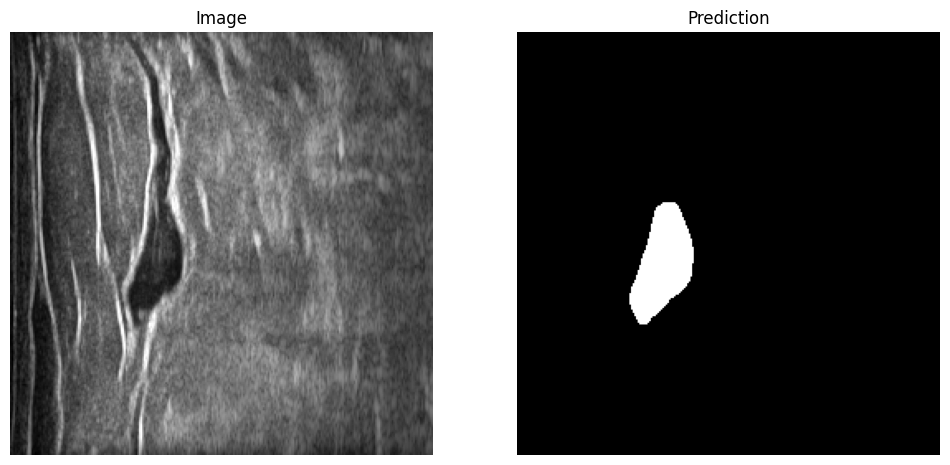

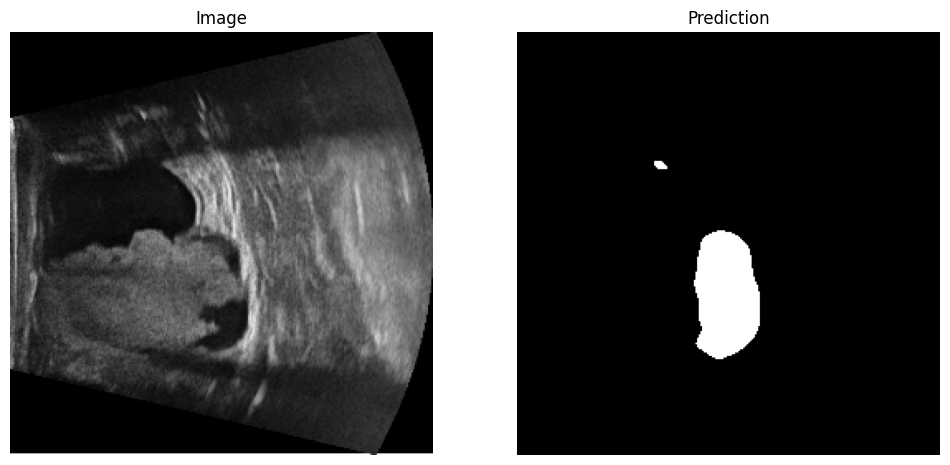

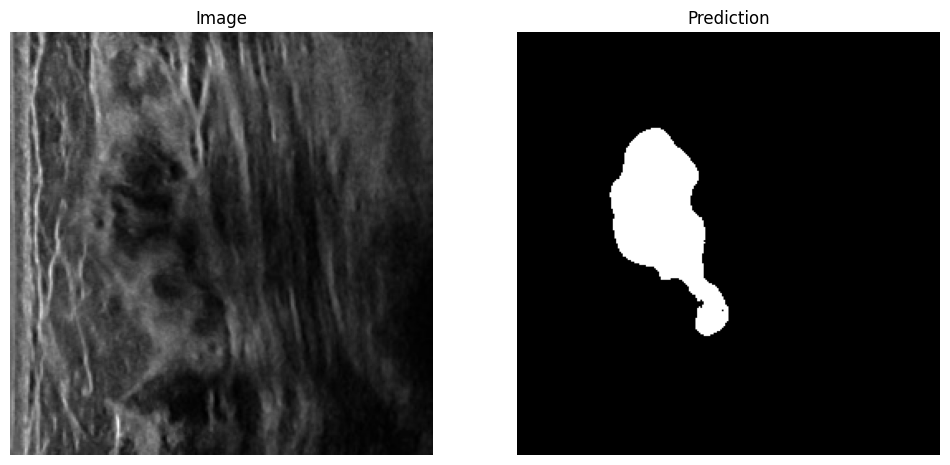

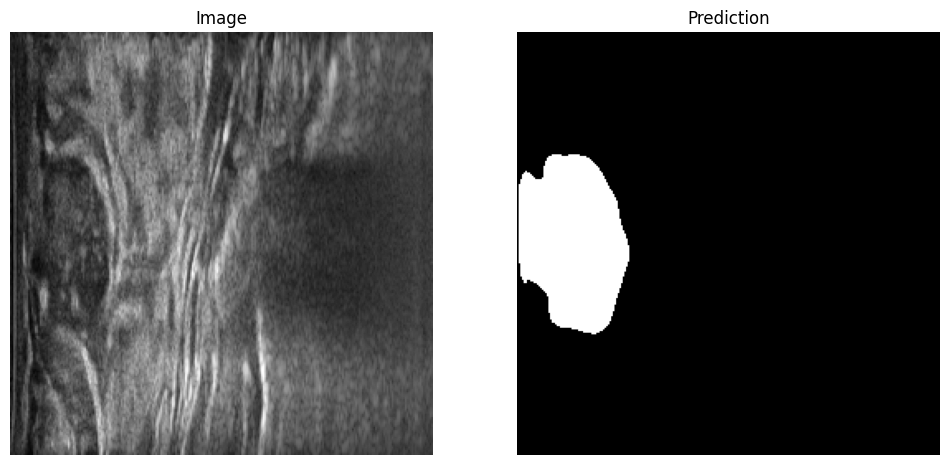

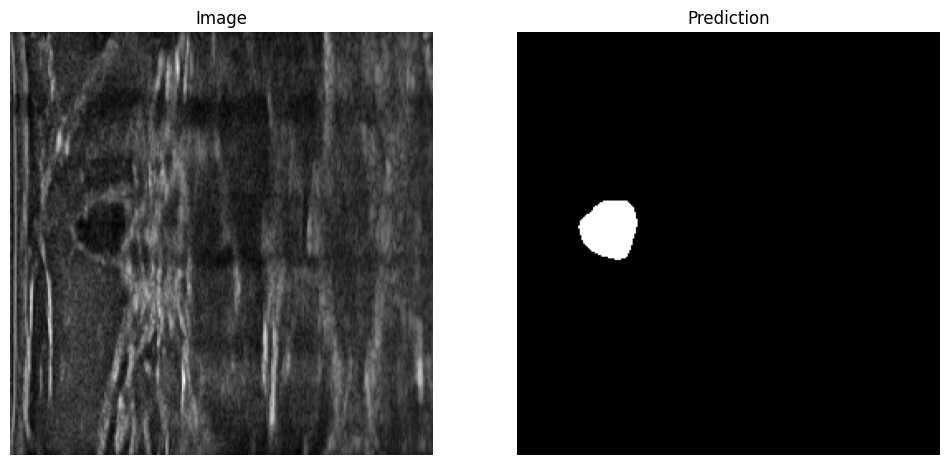

...

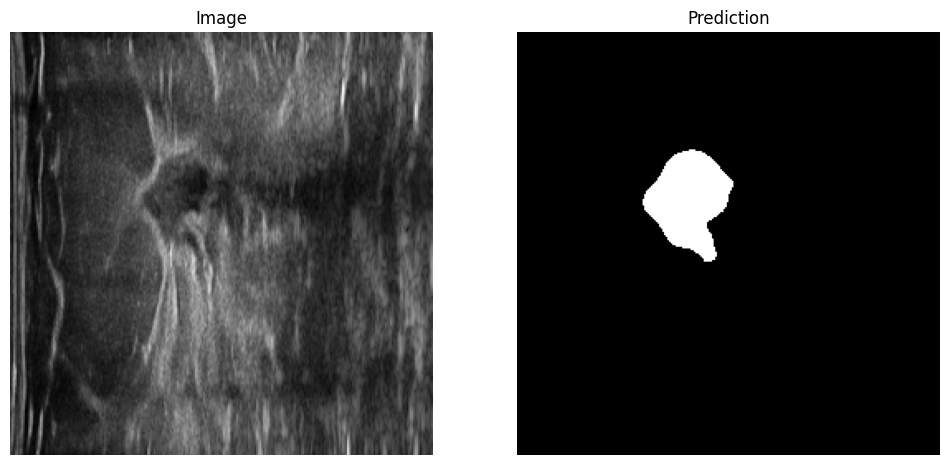

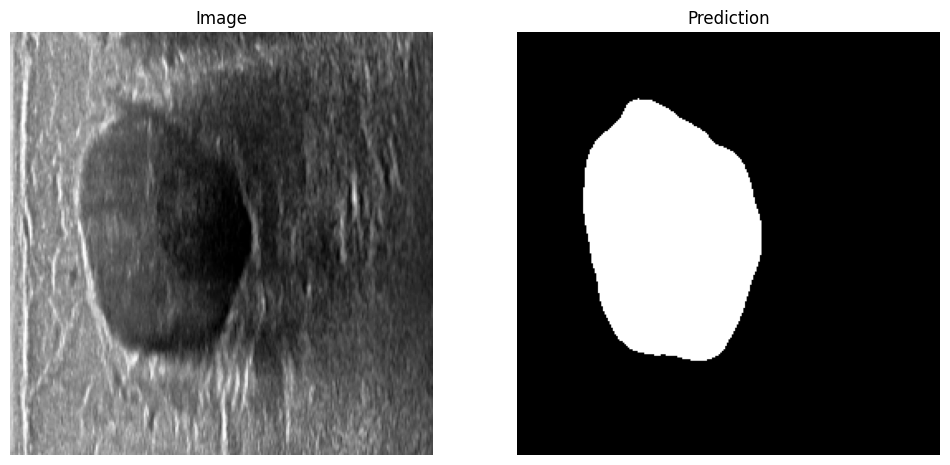

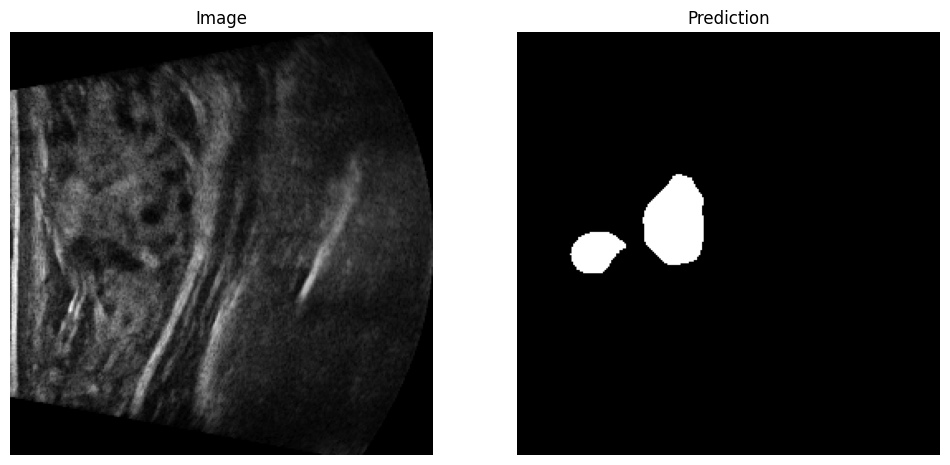

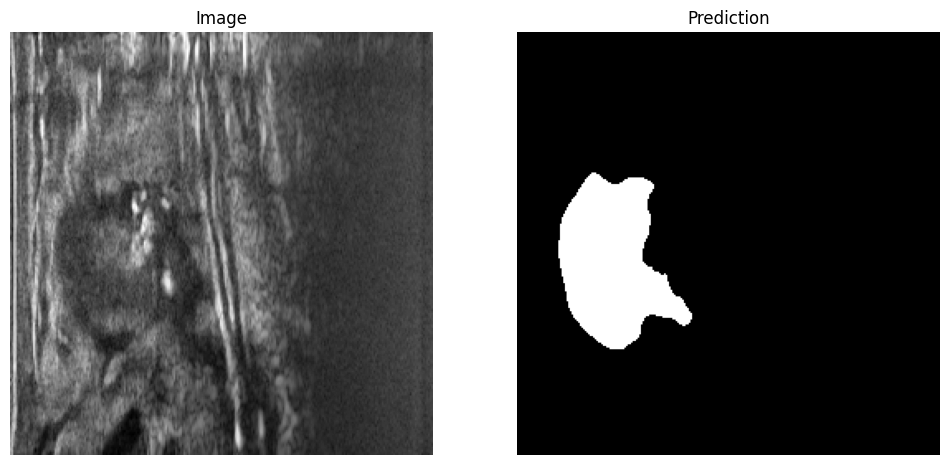

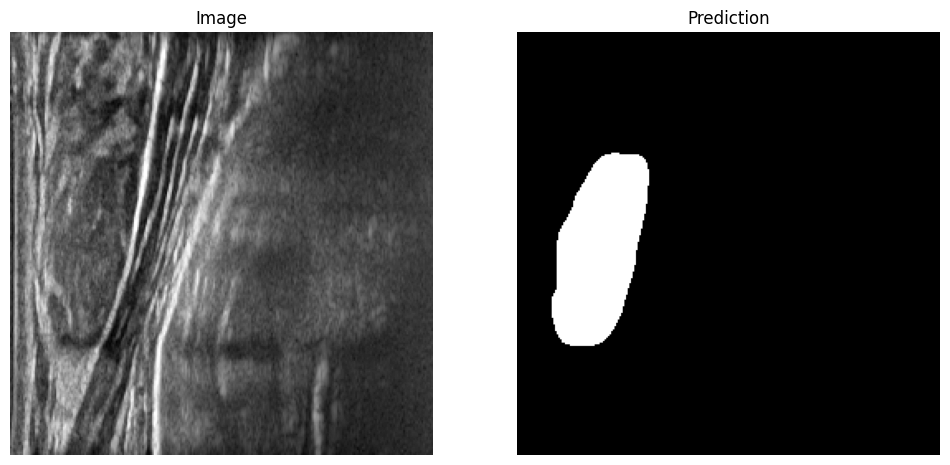

In [ ]:
#To load the image against the prediction
import os
import matplotlib.pyplot as plt
import SimpleITK as sitk

# Define the paths to the images and predictions directories
images_dir = '/content/nnUNetFrame/dataset/nnUNet_raw/Dataset001_BreastTumor/imagesTs'
predictions_dir = '/content/nnUNetFrame/dataset/nnUNet_results/Dataset001_BreastTumor/nnUNet_predictions'

# List all files in the images directory
image_files = os.listdir(images_dir)
image_files.sort()

# List all files in the predictions directory
prediction_files = os.listdir(predictions_dir)
prediction_files.sort()

# Visualize each image and its corresponding prediction
for image_file, prediction_file in zip(image_files, prediction_files):
    # Load the image and prediction using SimpleITK
    image_path = os.path.join(images_dir, image_file)
    image = sitk.ReadImage(image_path)

    prediction_path = os.path.join(predictions_dir, prediction_file)
    prediction = sitk.ReadImage(prediction_path)

    # Convert SimpleITK images to numpy arrays
    image_array = sitk.GetArrayFromImage(image)
    prediction_array = sitk.GetArrayFromImage(prediction)

    # Plot the image and prediction side by side
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Display the image
    axes[0].imshow(image_array, cmap='gray')
    axes[0].set_title('Image')
    axes[0].axis('off')

    # Display the prediction
    axes[1].imshow(prediction_array, cmap='gray')
    axes[1].set_title('Prediction')
    axes[1].axis('off')

    plt.show()


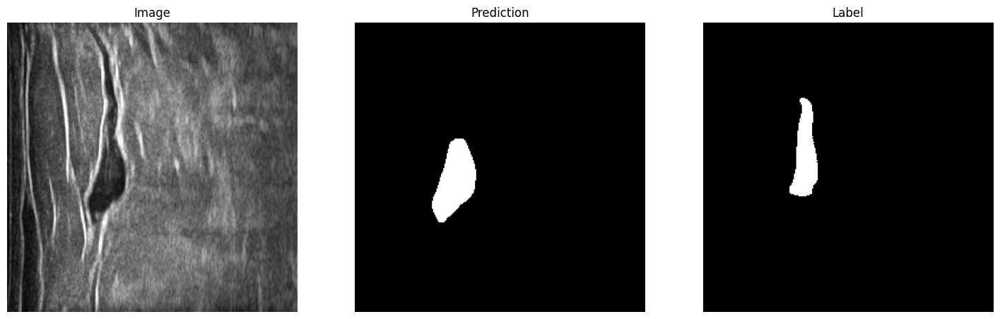

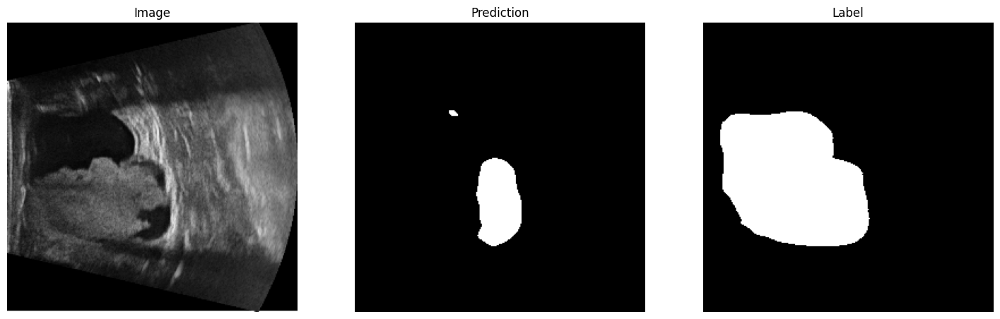

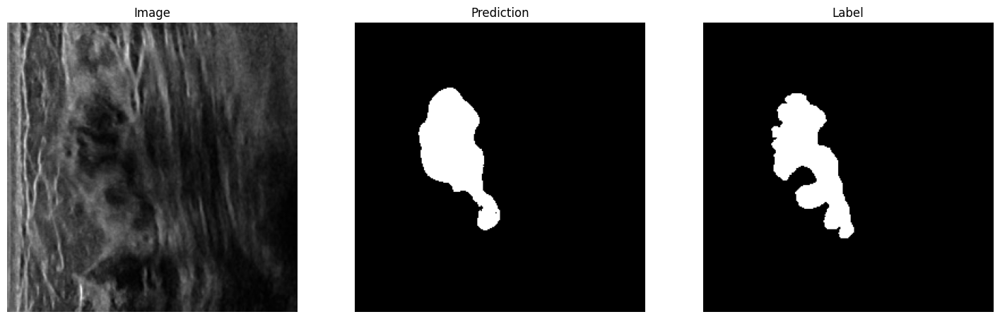

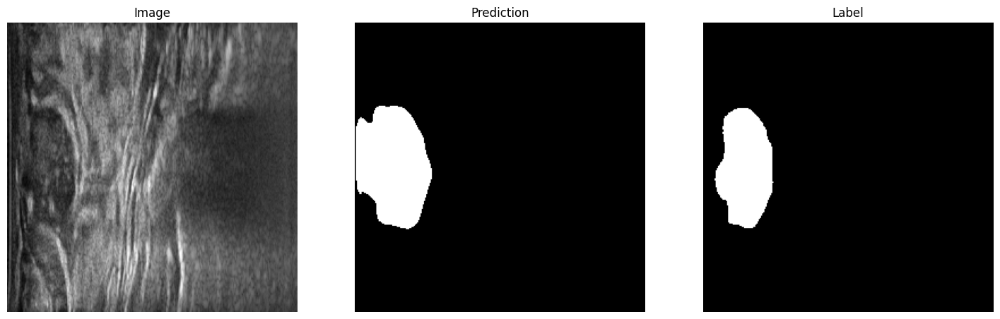

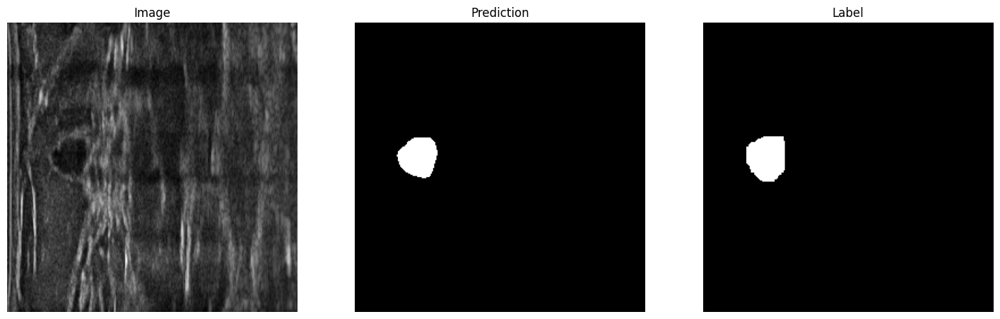

...

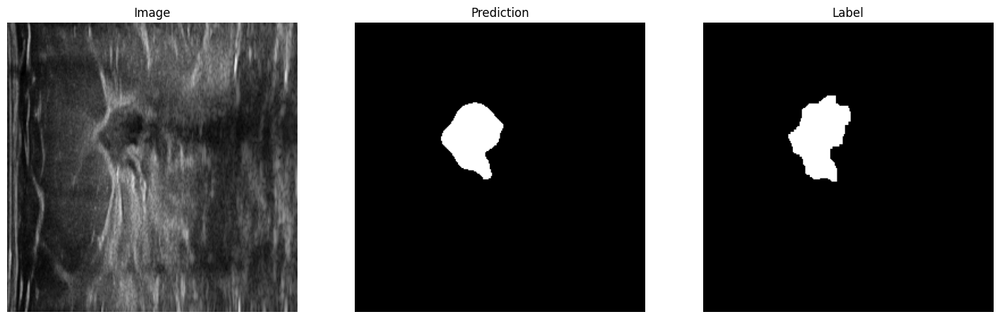

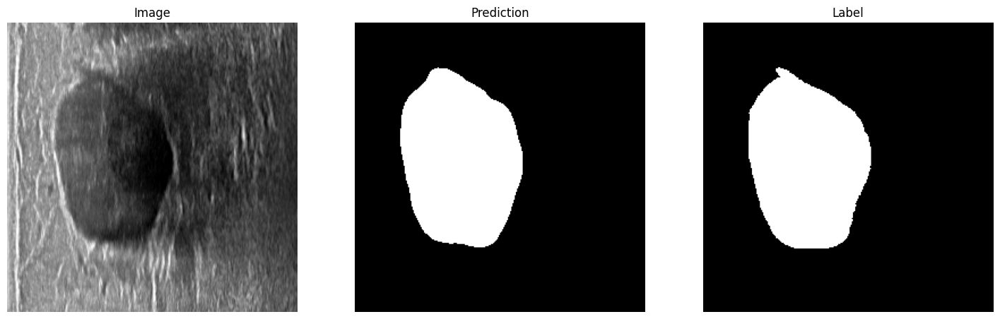

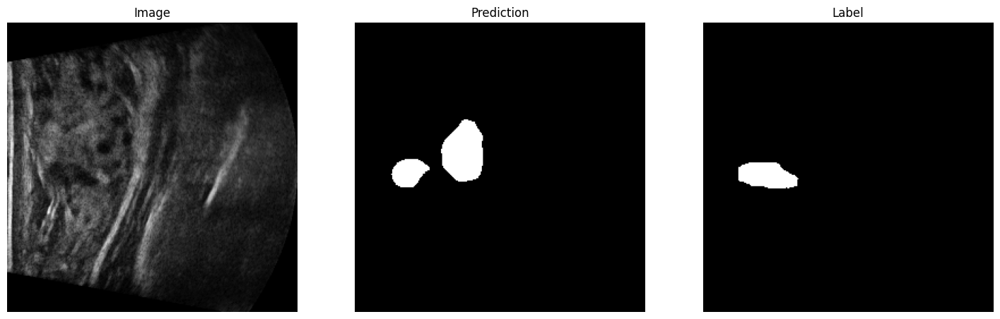

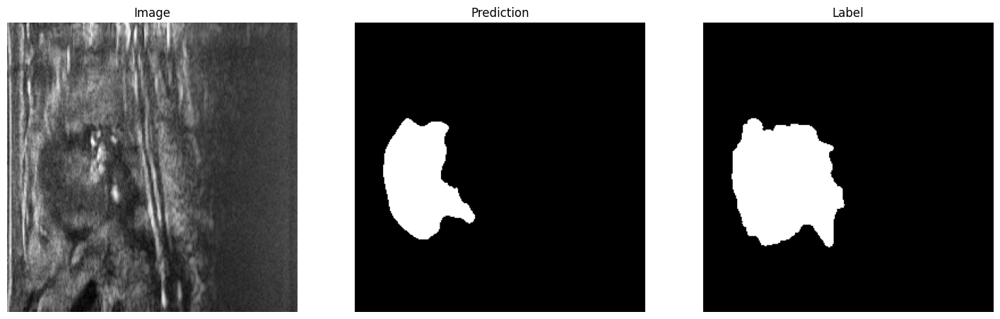

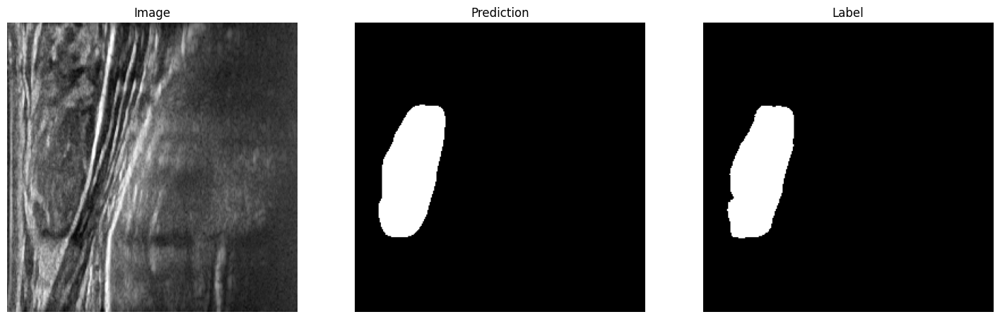

In [ ]:
#To load the image and the corresponding label against their prediction for confirmation of results.
import os
import matplotlib.pyplot as plt
import SimpleITK as sitk

# Define the paths to the images, predictions, and labels directories
images_dir = '/content/nnUNetFrame/dataset/nnUNet_raw/Dataset001_BreastTumor/imagesTs'
predictions_dir = '/content/nnUNetFrame/dataset/nnUNet_results/Dataset001_BreastTumor/nnUNet_predictions'
labels_dir = '/content/nnUNetFrame/dataset/nnUNet_raw/nnUNet_raw_data/nifti_labels'

# List all files in the images directory
image_files = os.listdir(images_dir)
image_files.sort()

# List all files in the predictions directory
prediction_files = os.listdir(predictions_dir)
prediction_files.sort()

# List all files in the labels directory
label_files = os.listdir(labels_dir)
label_files.sort()

# Visualize each image, prediction, and label
for image_file, prediction_file, label_file in zip(image_files, prediction_files, label_files):
    # Load the image, prediction, and label using SimpleITK
    image_path = os.path.join(images_dir, image_file)
    image = sitk.ReadImage(image_path)

    prediction_path = os.path.join(predictions_dir, prediction_file)
    prediction = sitk.ReadImage(prediction_path)

    label_path = os.path.join(labels_dir, label_file)
    label = sitk.ReadImage(label_path)

    # Convert SimpleITK images to numpy arrays
    image_array = sitk.GetArrayFromImage(image)
    prediction_array = sitk.GetArrayFromImage(prediction)
    label_array = sitk.GetArrayFromImage(label)

    # Plot the image, prediction, and label side by side
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Display the image
    axes[0].imshow(image_array, cmap='gray')
    axes[0].set_title('Image')
    axes[0].axis('off')

    # Display the prediction
    axes[1].imshow(prediction_array, cmap='gray')
    axes[1].set_title('Prediction')
    axes[1].axis('off')

    # Display the label
    axes[2].imshow(label_array, cmap='gray')
    axes[2].set_title('Label')
    axes[2].axis('off')

    plt.show()


# ***DISCUSSION & CONCLUSION***

Based on the results presented, the model achieved an impressive accuracy of 96.16%. However, upon inspecting the predicted tumor masks alongside the original images and their labels, it's evident that the model's performance, particularly in delineating tumor boundaries, is not entirely satisfactory. This observation applies to only a few cases and is likely due to the relatively low number of training epochs (56 epochs). Extending the training duration to 300 epochs or more is crucial to overcome this limitation and establish a robust benchmark for accurately segmenting breast ultrasound tumorous regions. Furthermore, integrating additional datasets is important so that the model can have more images to learn from.

Additionally, it's worth noting that the model successfully identified the presence of multiple tumors within individual images; even though we excluded multiple masks for simplicity purposes. Furthermore, the incorporation of synthesized out-of-distribution data (African data) has shown promising results. Although deployability isn't guaranteed based on the current testing outcomes, these findings suggest optimistic prospects for further refinement and practical application in real-world scenarios.






# ***`CITATIONS`***
Isensee, F., Jaeger, P. F., Kohl, S. A., Petersen, J., & Maier-Hein, K. H. (2021). nnU-Net: a self-configuring method for deep learning-based biomedical image segmentation. Nature methods, 18(2), 203-211.

Pawłowska, A., Ćwierz-Pieńkowska, A., Domalik, A., Jaguś, D., Kasprzak, P., Matkowski, R., ... & Żołek, N. (2024). Curated benchmark dataset for ultrasound based breast lesion analysis. Scientific Data, 11(1), 148.

Aliyu, L., Kurjak, A., Wataganara, T., de Sá, R., Pooh, R., Sen, C., Ebrashy, A., Adra, A. & Stanojevic, M. (2016). Ultrasound in Africa: what can really be done?. Journal of Perinatal Medicine, 44(2), 119-123. https://doi.org/10.1515/jpm-2015-0224